2025-04-13 20:03:07.052984: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2025-04-13 20:03:07.053019: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-04-13 20:03:07.053024: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-04-13 20:03:07.053040: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-04-13 20:03:07.053052: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2025-04-13 20:03:07.928213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


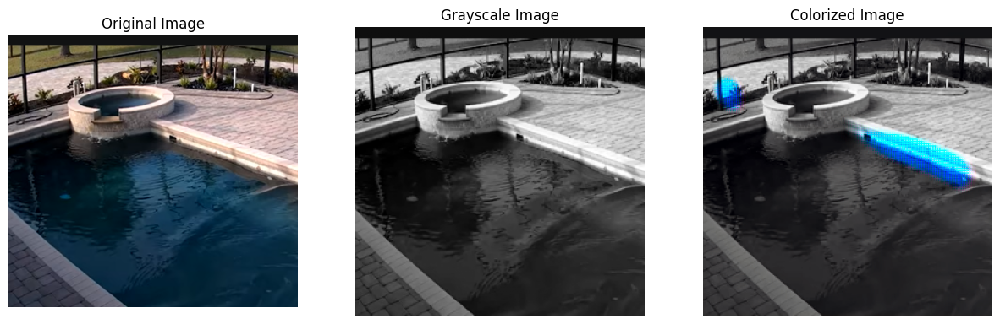

In [1]:
import numpy as np
import cv2
from tensorflow.keras.models import load_model  # type: ignore
from tensorflow.keras.preprocessing.image import img_to_array, load_img # type: ignore
import matplotlib.pyplot as plt

from util import lab_to_rgb, preprocess_image

# Load the trained U-Net model
model = load_model("/Users/mehherghevandiani/Documents/personal/capstone/u_net_70_epoch_iter_4.h5", compile=False)

# Function to load and preprocess an image for testing
# def preprocess_image(image_path, img_size=(256, 256)):
#     img = load_img(image_path, target_size=img_size)
#     img = img_to_array(img)
#     original_image = img / 255.0  # Normalize the original image to [0, 1]
#     lab_image = cv2.cvtColor((original_image * 255).astype(np.uint8), cv2.COLOR_RGB2LAB)
#     l_channel = lab_image[:, :, 0:1] # / 100.0  # Normalize L channel to [0, 1] (LAB L channel is in [0, 100])
#     return original_image, l_channel



# Function to postprocess and convert LAB image to RGB
# def lab_to_rgb(l_channel, ab_channels):
#     l_channel = (l_channel * 100).astype(np.uint8)  # Scale L channel back to [0, 100]
#     ab_channels = (ab_channels * 128).astype(np.int8)  # Scale AB channels back to [-128, 127]
#     lab_image = np.concatenate((l_channel, ab_channels), axis=-1)
#     rgb_image = cv2.cvtColor(lab_image, cv2.COLOR_LAB2RGB)
#     return rgb_image

# Python
# def lab_to_rgb(l_channel, ab_channels):
#     l_channel = (l_channel * 100).astype(np.uint8)  # Scale L channel back to [0, 100]
#     ab_channels = (ab_channels * 128).astype(np.uint8)  # Scale AB channels back to [0, 255]
#     lab_image = np.concatenate((l_channel, ab_channels), axis=-1)
#     rgb_image = cv2.cvtColor(lab_image, cv2.COLOR_LAB2RGB)
#     return rgb_image
# Path to the test image
image_path = "/Users/mehherghevandiani/Documents/personal/capstone/data/cctv_data/no_human354.png"  # Replace with the path to your test image

original_image = load_img(image_path)
original_image = img_to_array(original_image) / 255.0  # Normalize the original image to [0, 1]
# Preprocess the image
l_channel, ab_channels = preprocess_image(image_path)

# Predict the AB channels using the model
l_channel_input = np.expand_dims(l_channel, axis=0)  # Add batch dimension
predicted_ab_channels = model.predict(l_channel_input)[0] # Remove batch dimension

# Postprocess the predicted LAB image to RGB
colorized_image = lab_to_rgb(l_channel, predicted_ab_channels)

# Convert the grayscale image for display
grayscale_image = l_channel[:, :, 0]  # Scale back to [0, 100] for visualization

# Display the original, grayscale, and colorized images
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Grayscale Image")
plt.imshow(grayscale_image, cmap="gray")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Colorized Image")
plt.imshow(colorized_image)
plt.axis("off")

plt.show()

In [2]:
print(predicted_ab_channels.min())
print(predicted_ab_channels.max())

-0.9971158
0.5748328


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


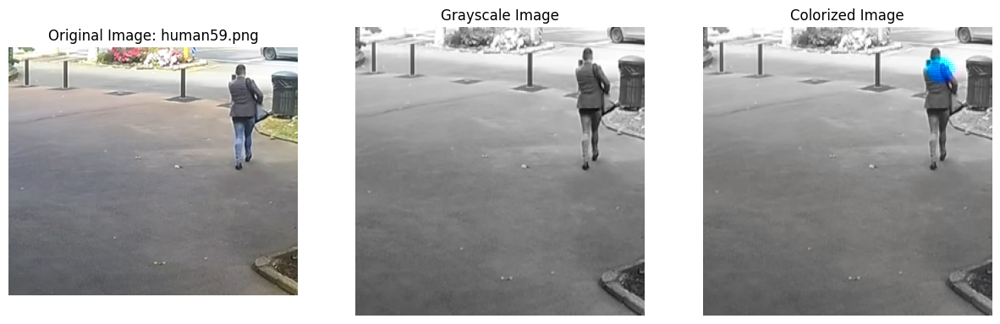

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


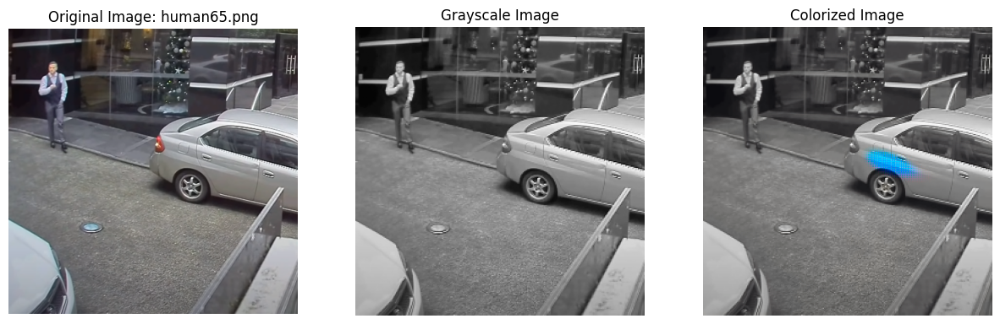

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


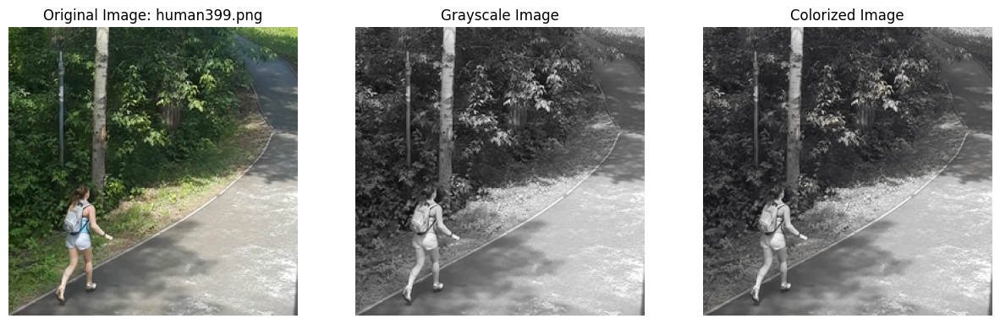

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


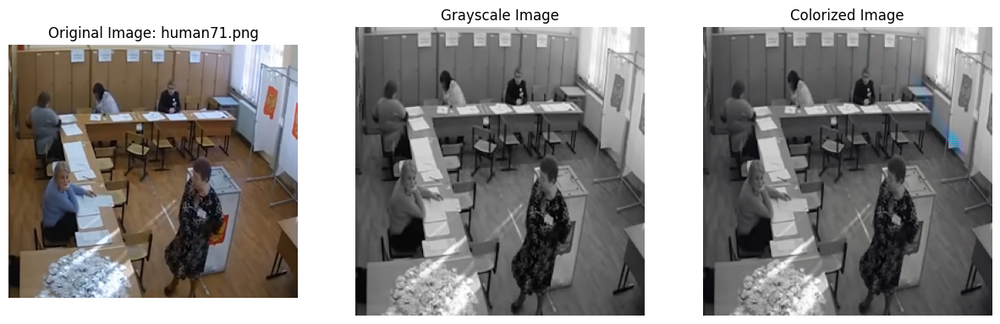

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


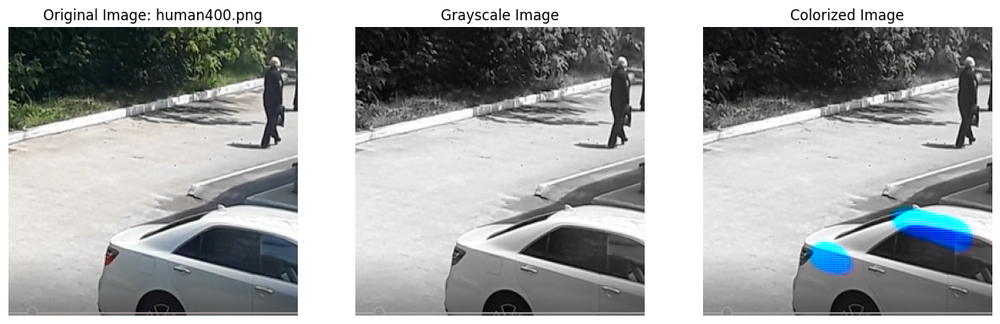

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


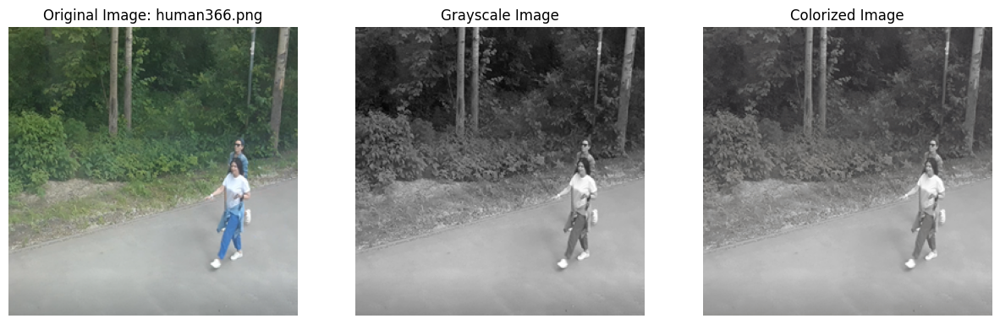

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


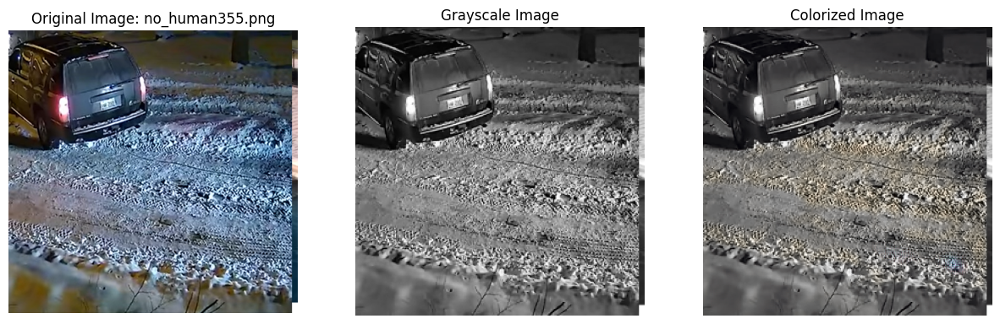

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


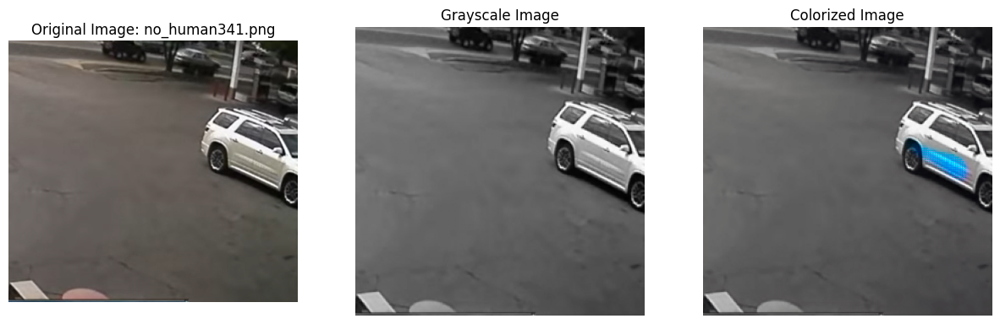

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


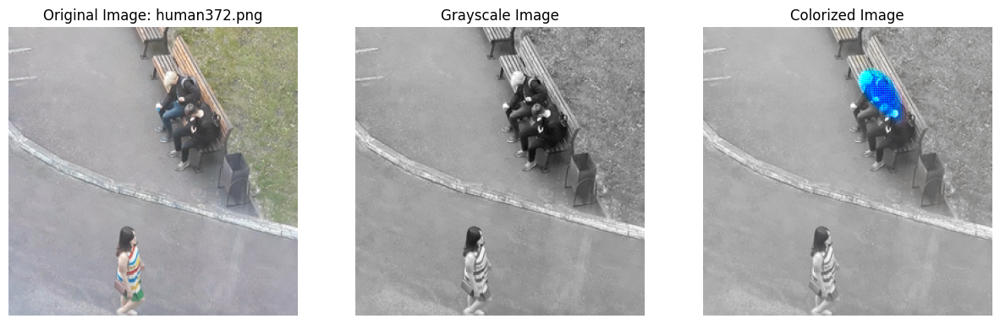

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


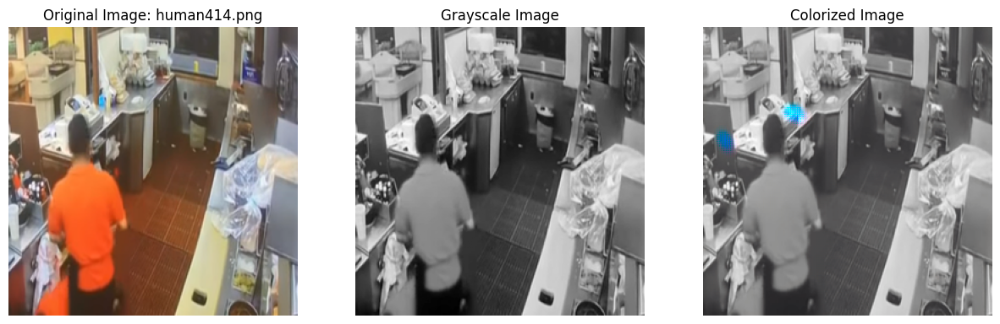

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


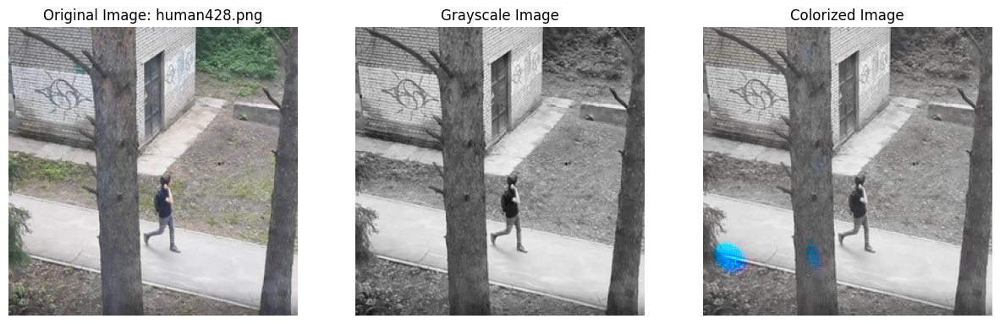

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


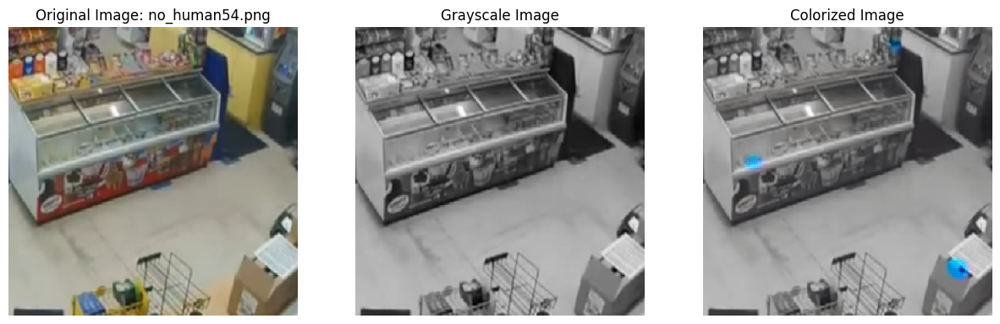

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


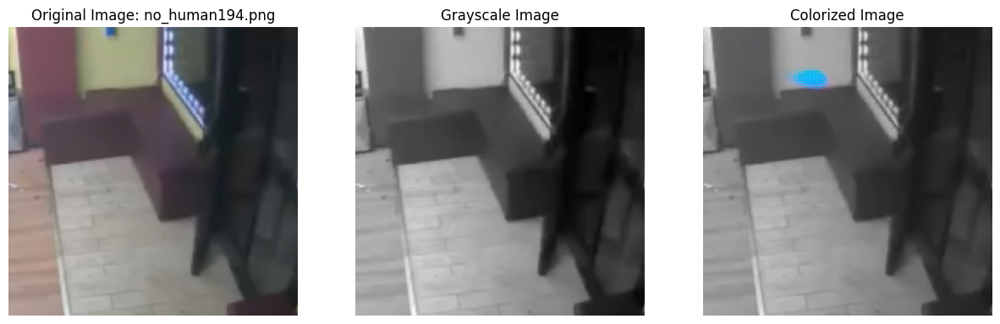

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


libpng warning: iCCP: known incorrect sRGB profile


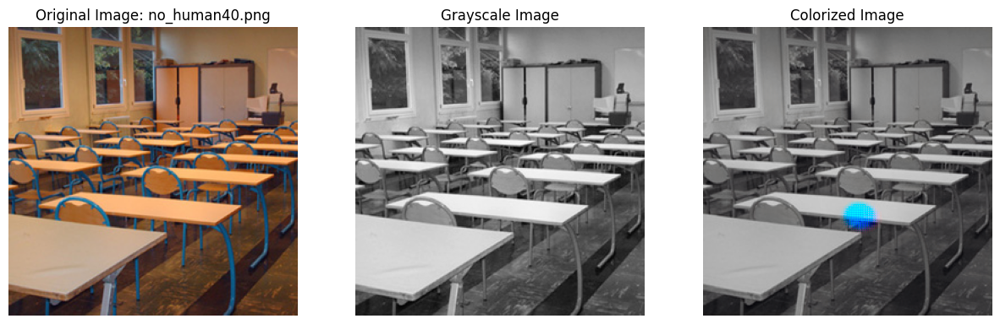

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


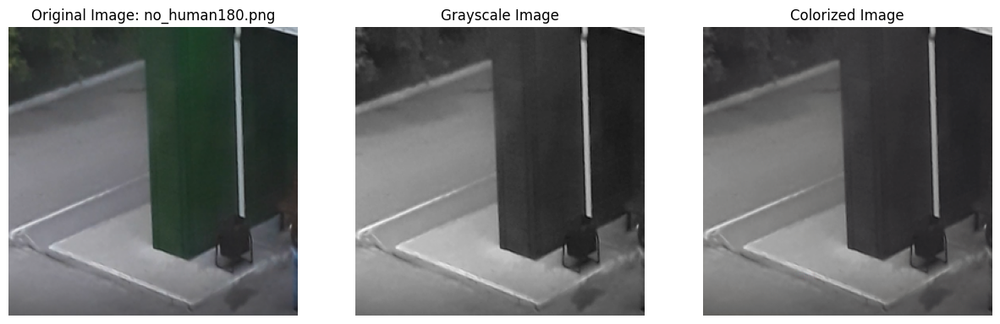

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


libpng warning: iCCP: known incorrect sRGB profile


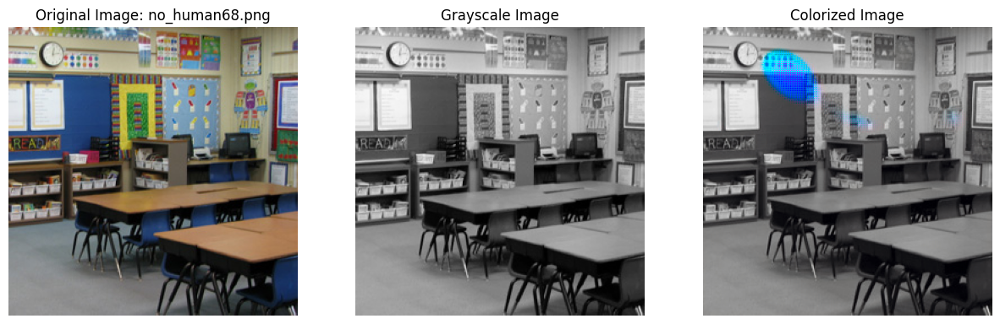

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


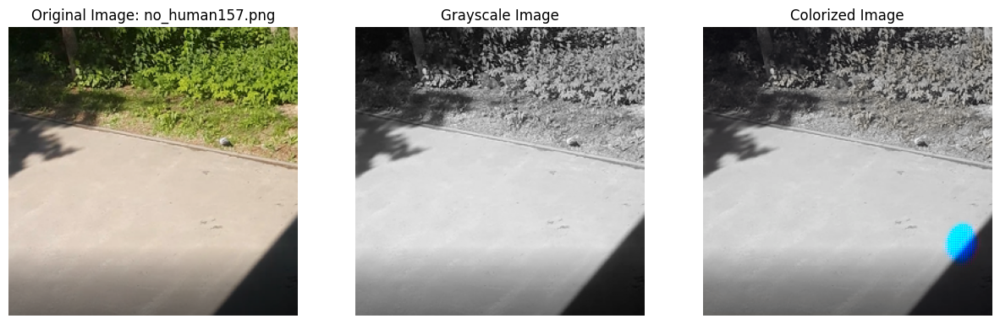

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


libpng warning: iCCP: known incorrect sRGB profile


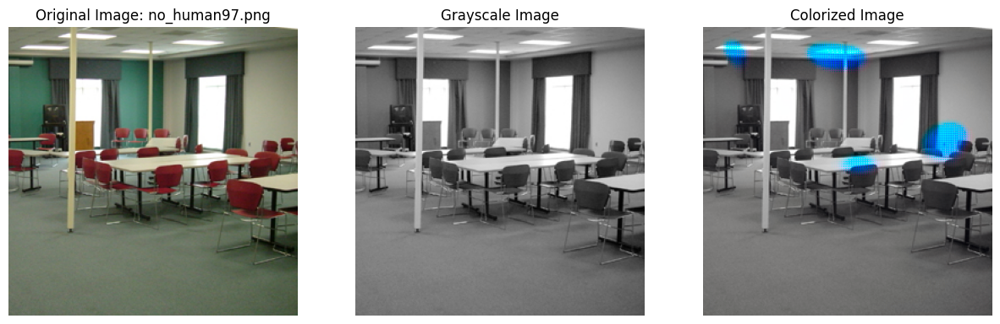

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


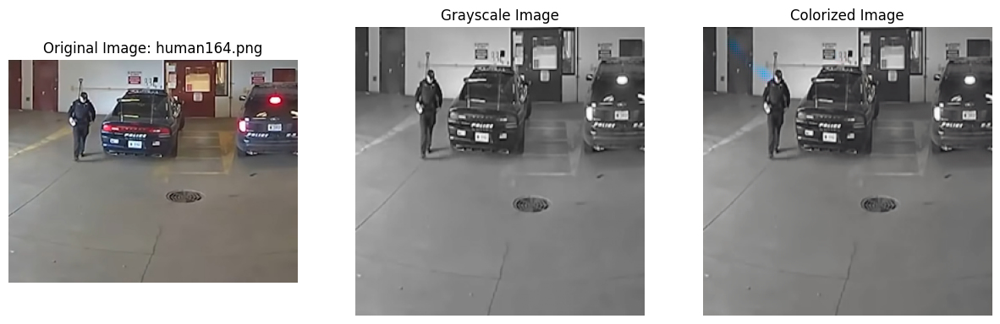

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


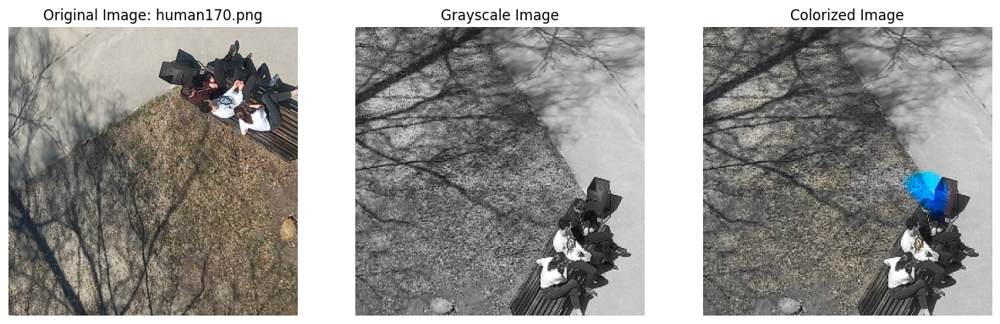

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


libpng warning: iCCP: known incorrect sRGB profile


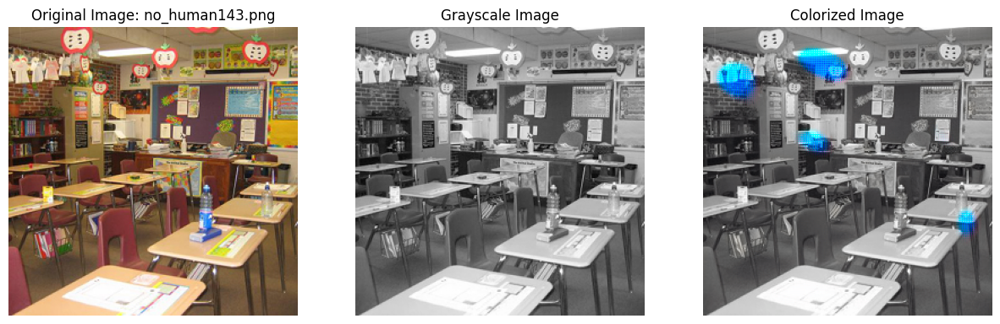

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


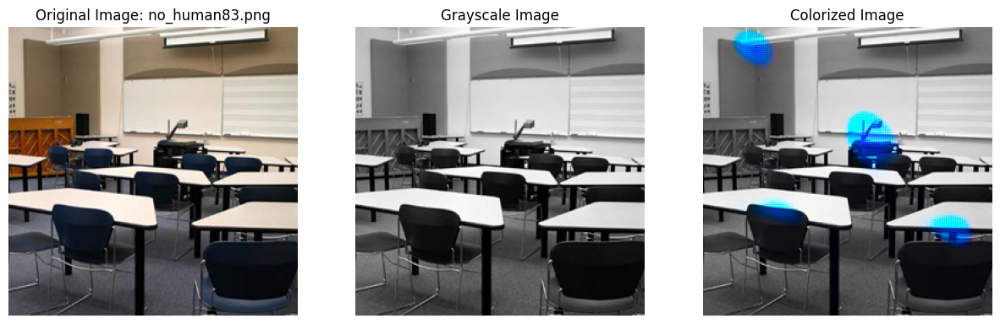

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


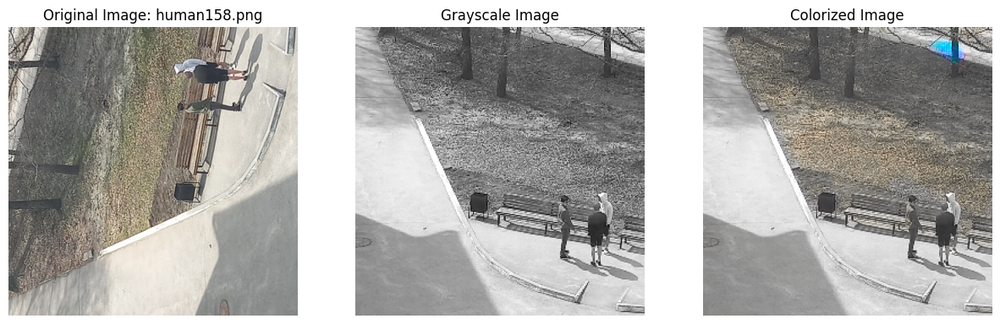

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


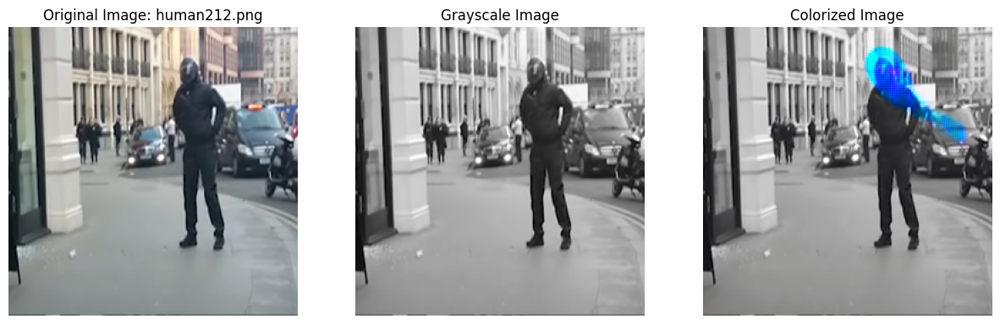

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


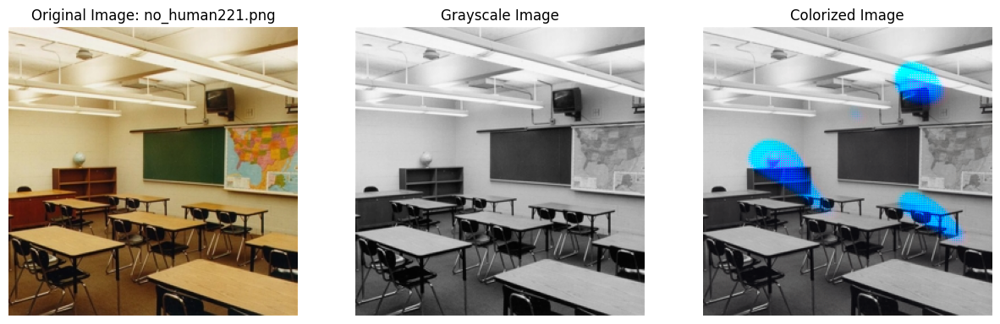

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


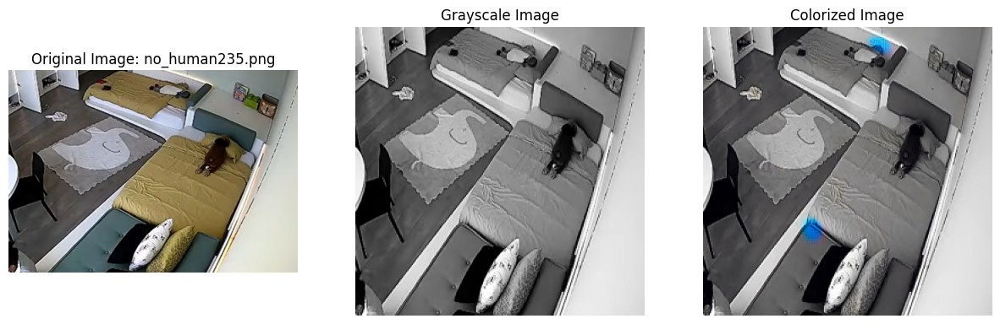

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


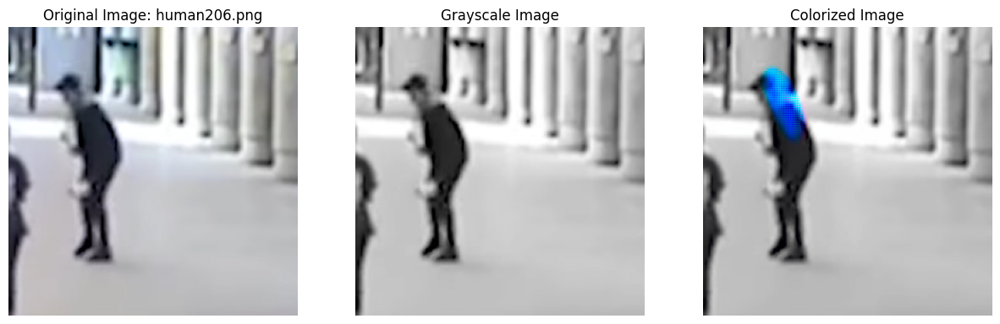

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


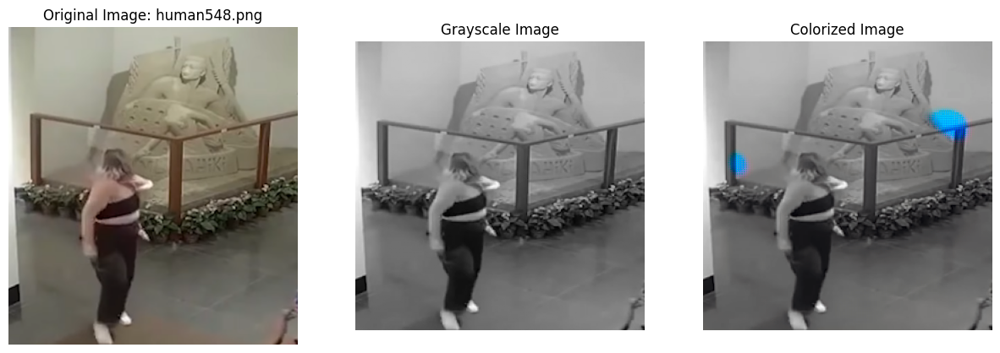

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


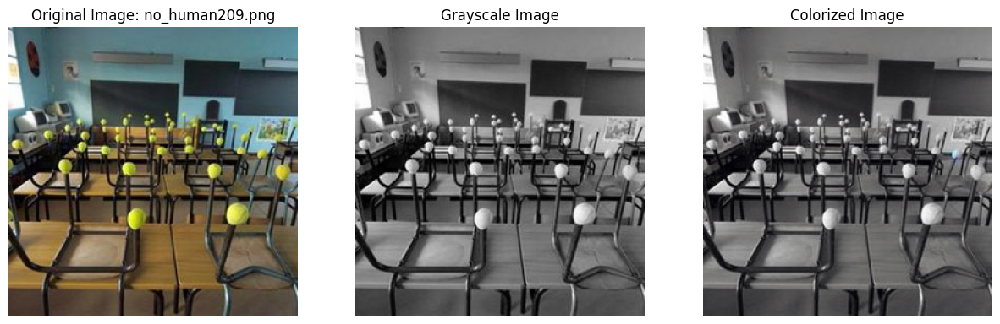

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


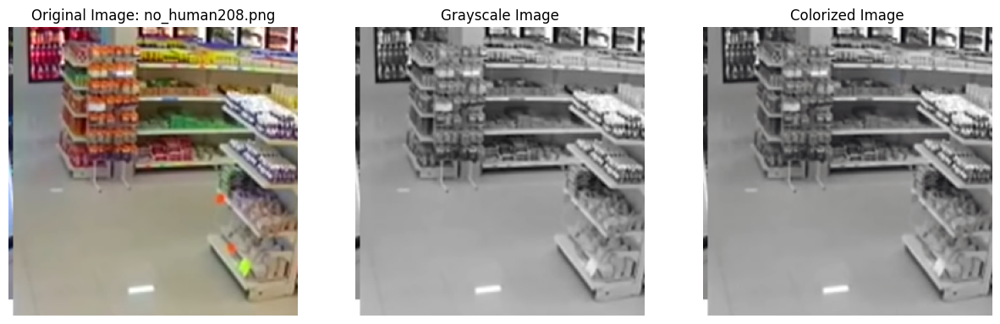

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


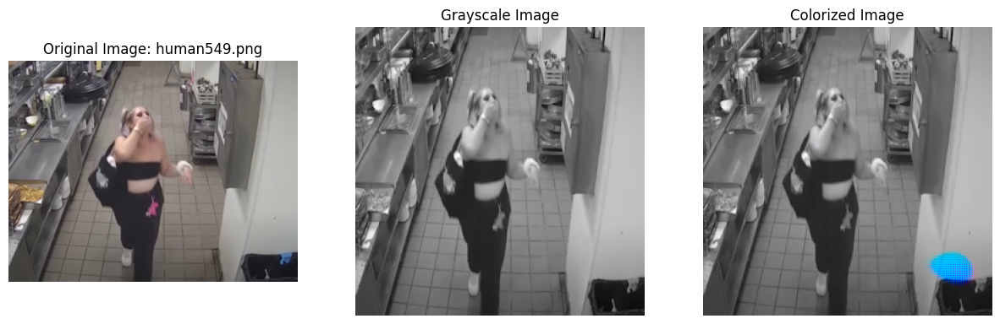

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


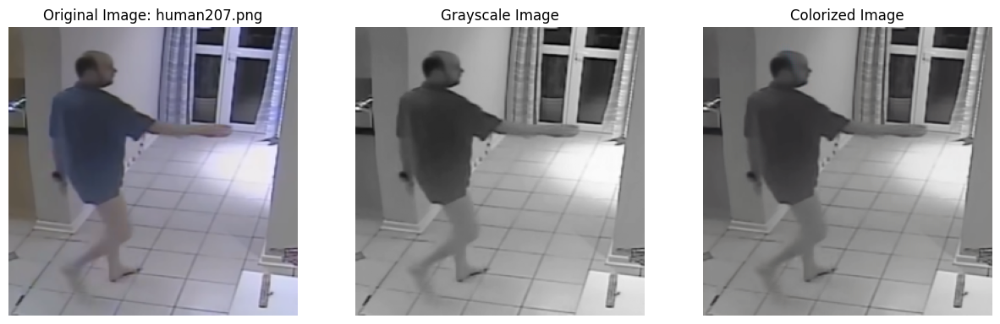

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


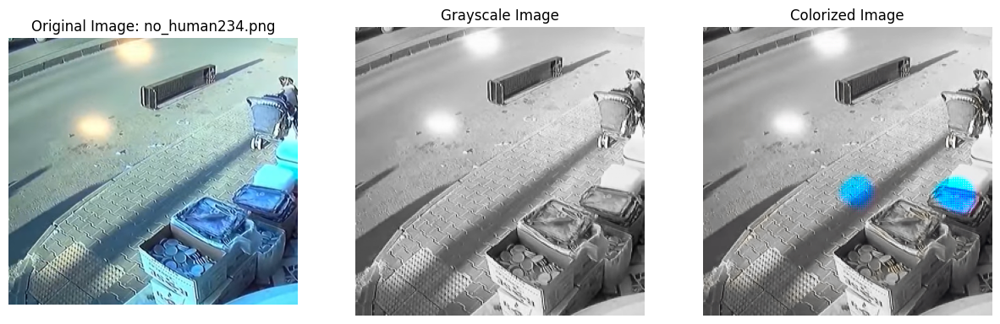

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


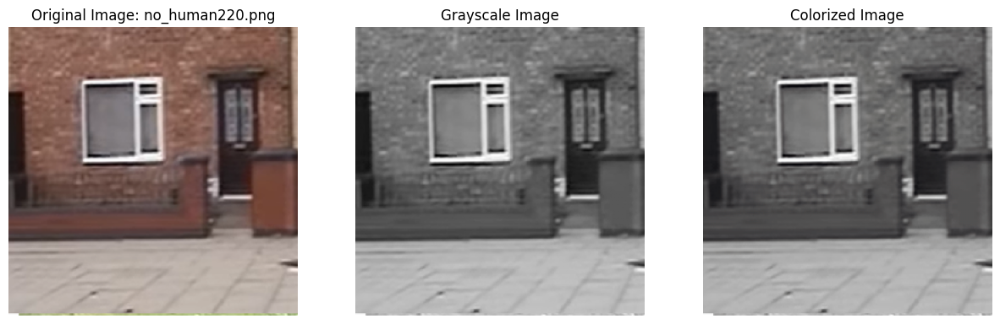

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


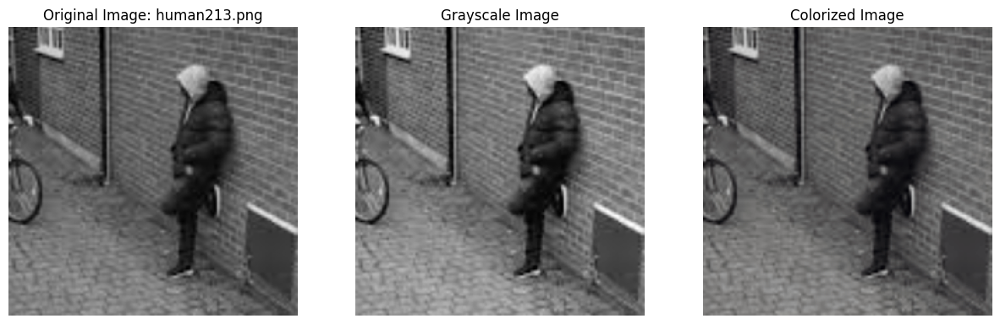

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


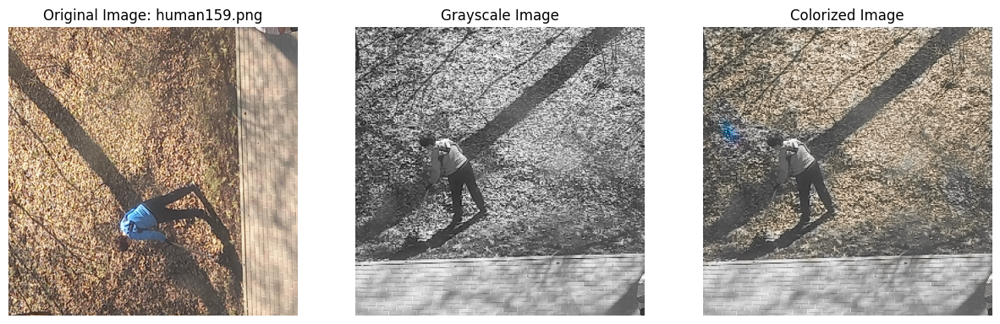

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


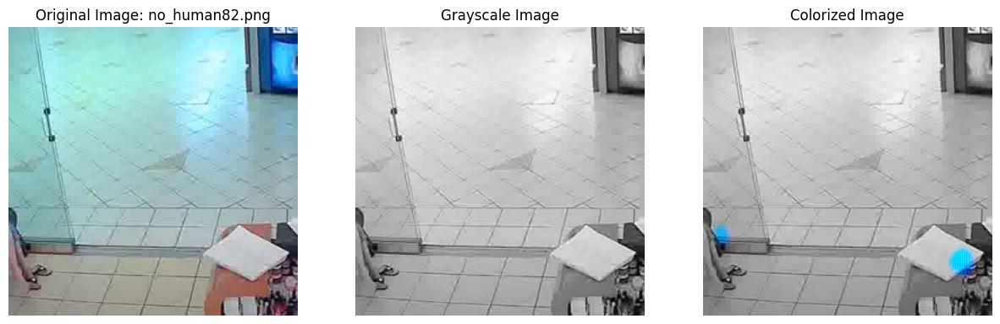

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


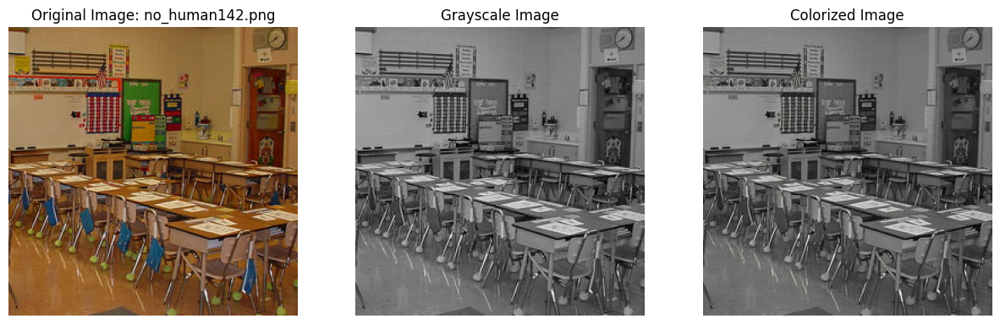

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


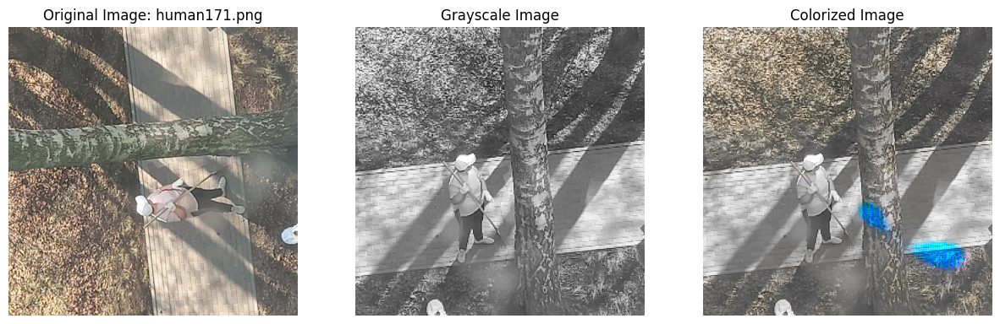

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


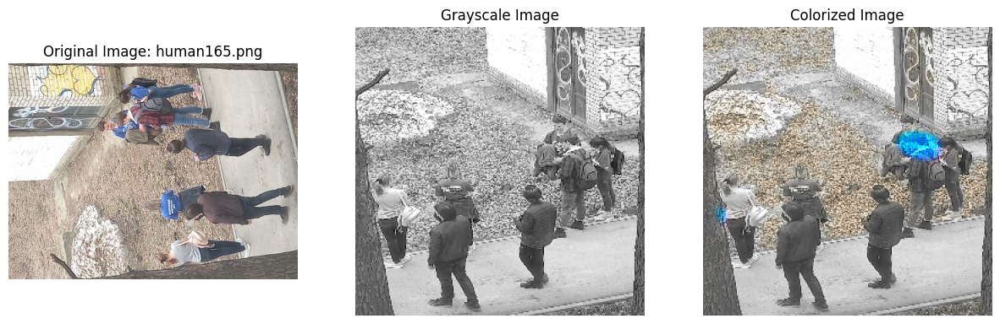

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


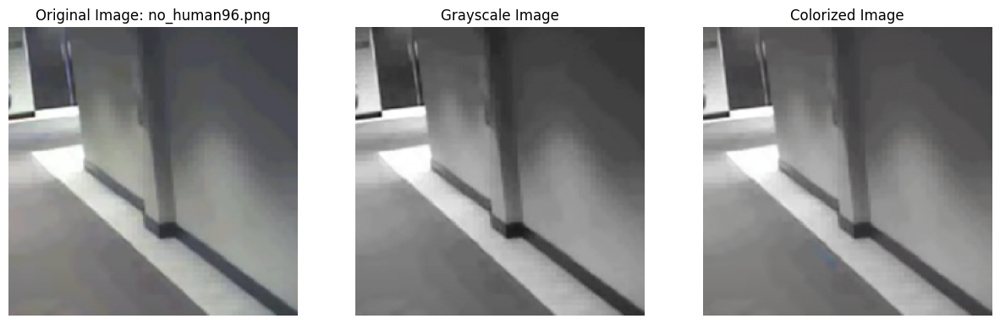

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


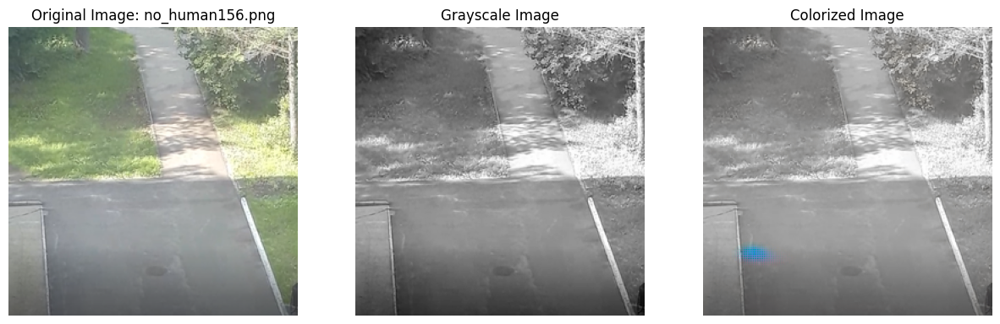

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


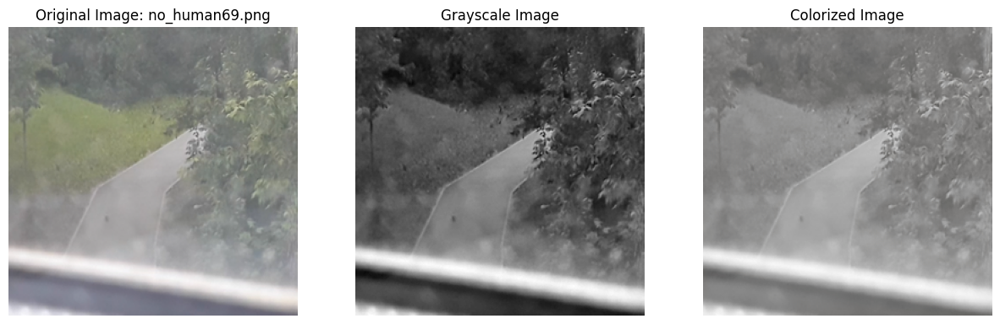

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


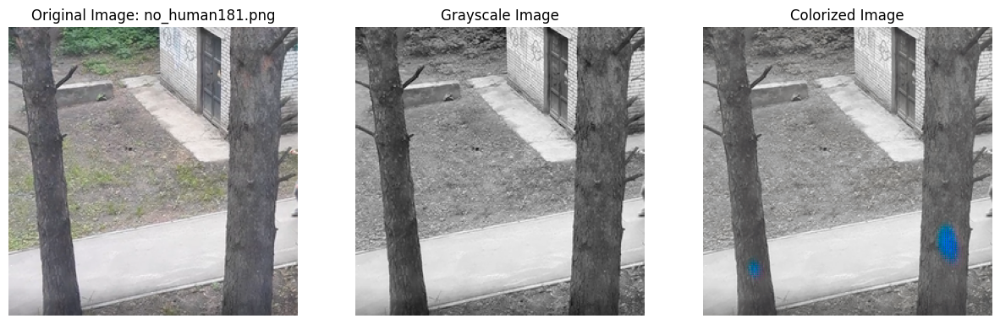

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


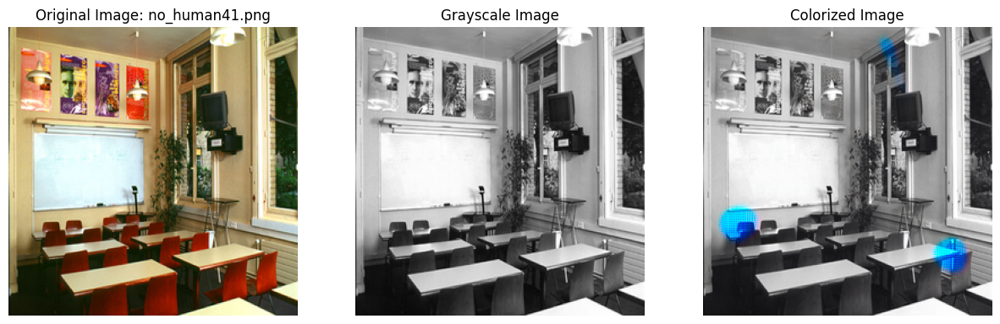

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


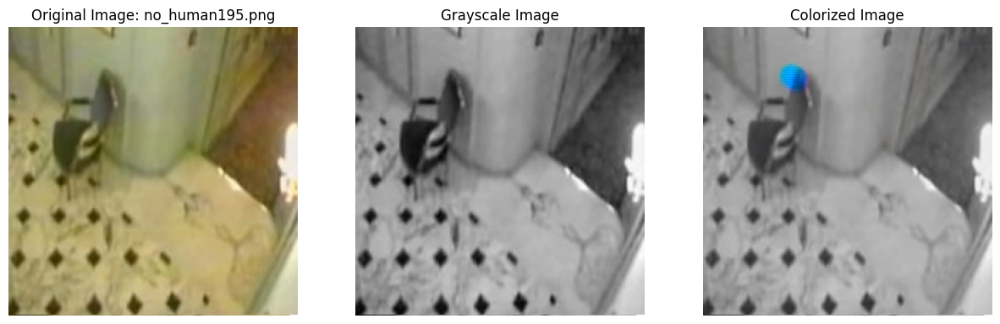

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


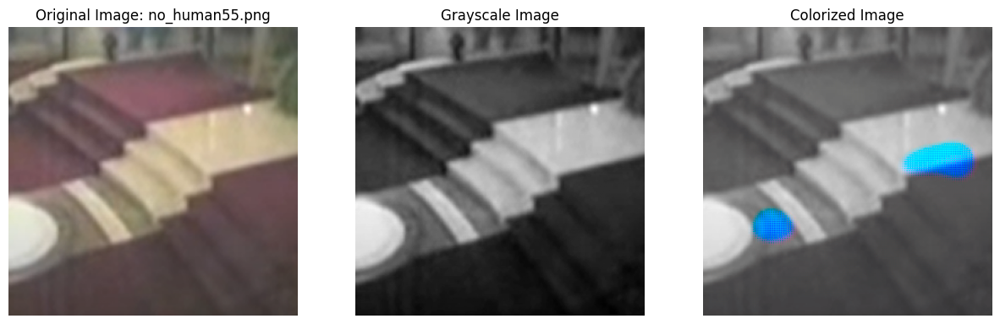

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


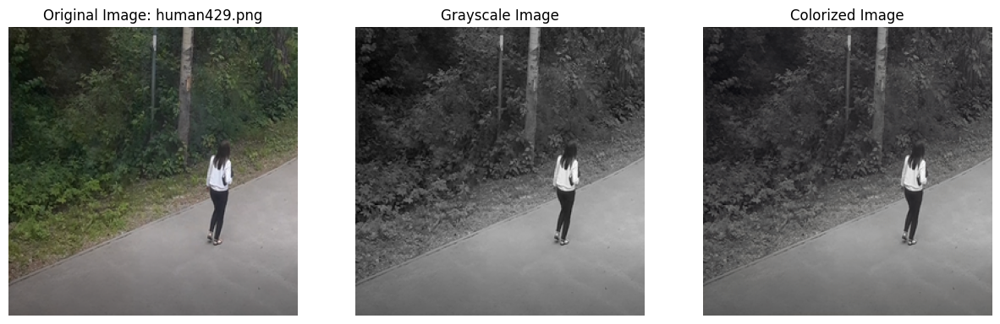

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


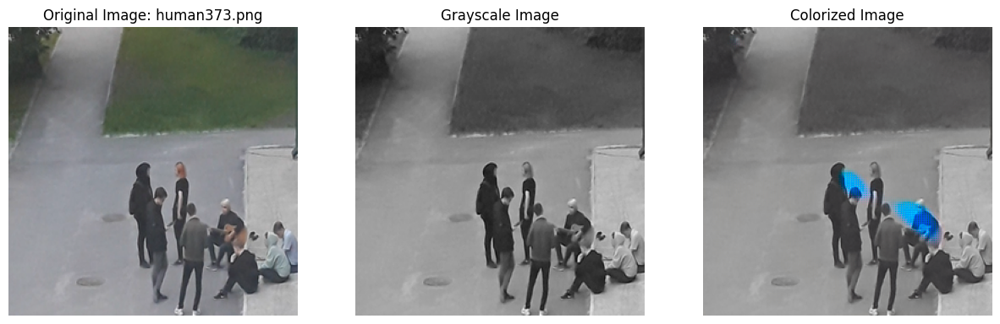

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


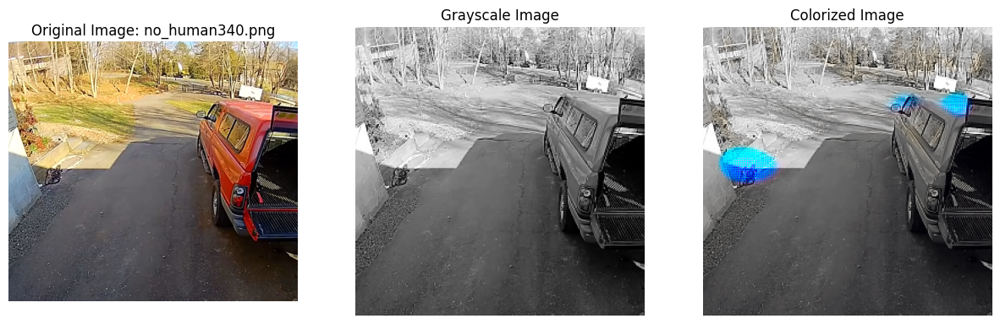

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


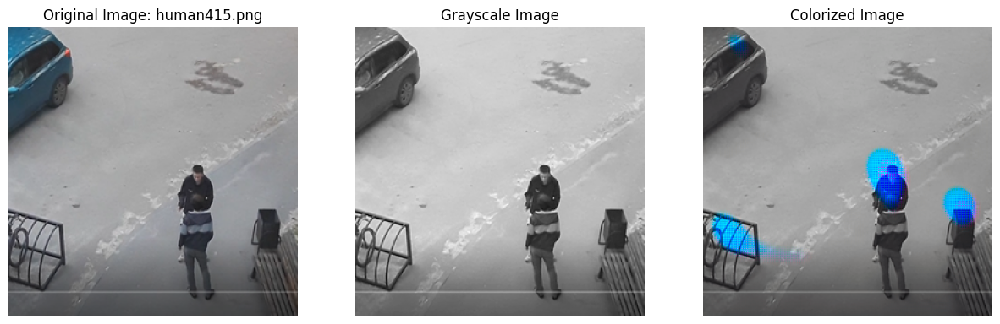

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


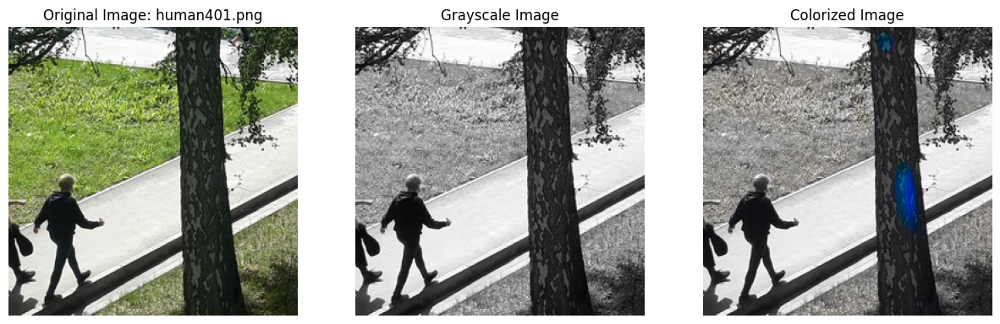

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


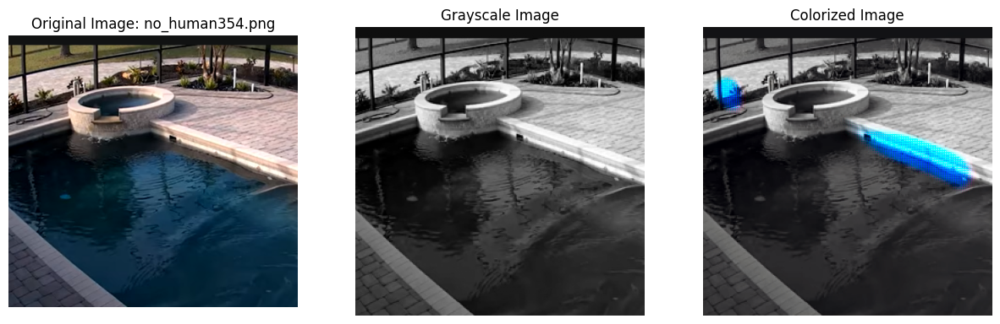

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


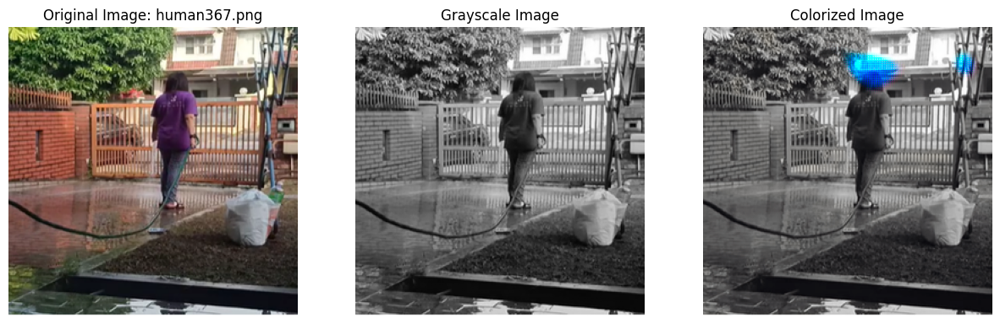

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


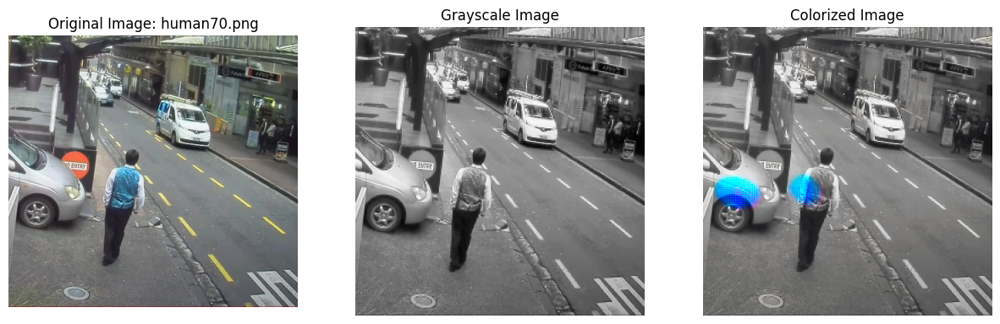

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


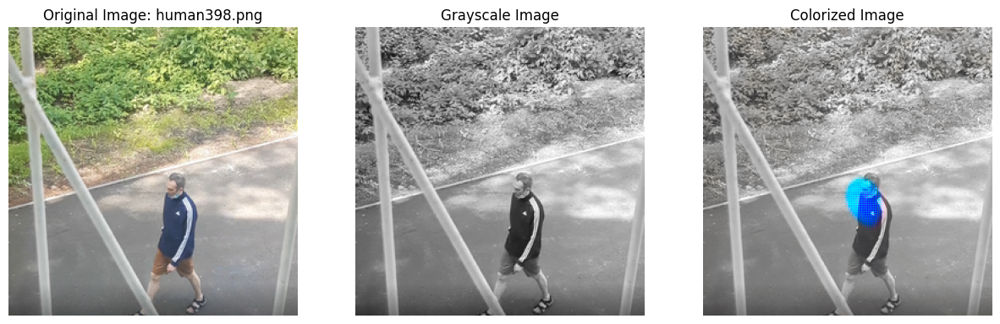

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


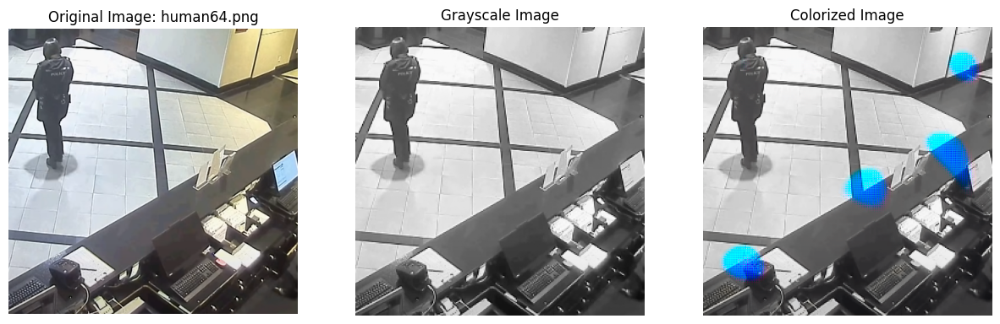

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


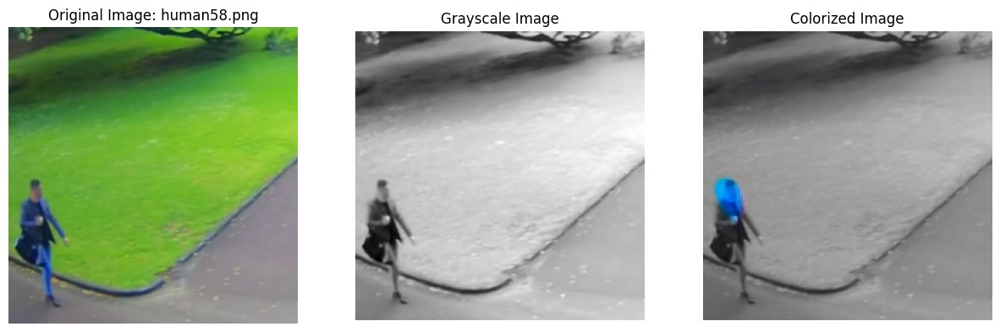

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


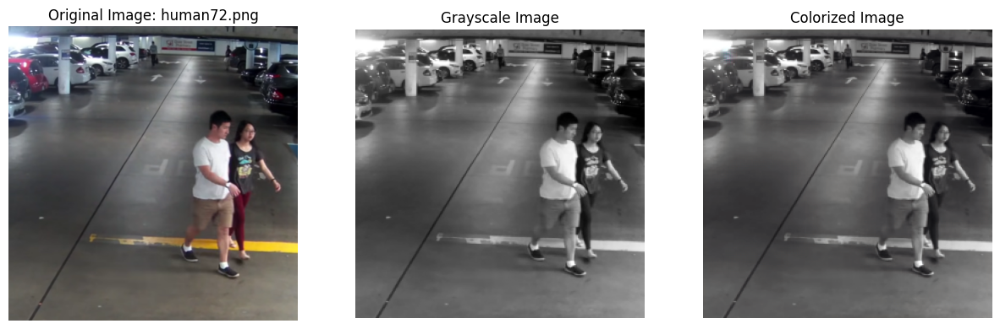

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


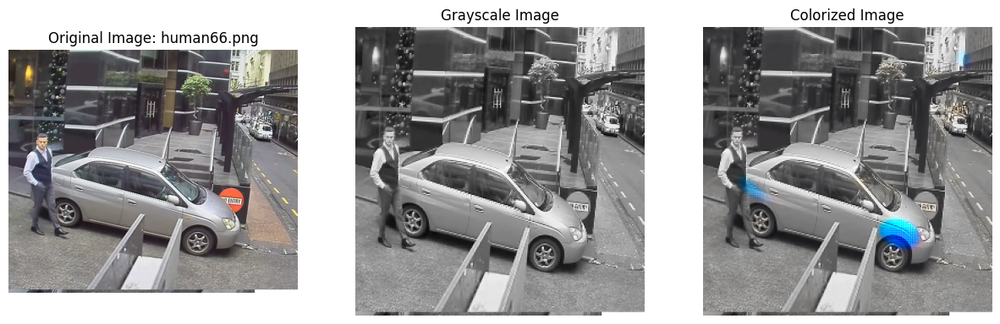

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


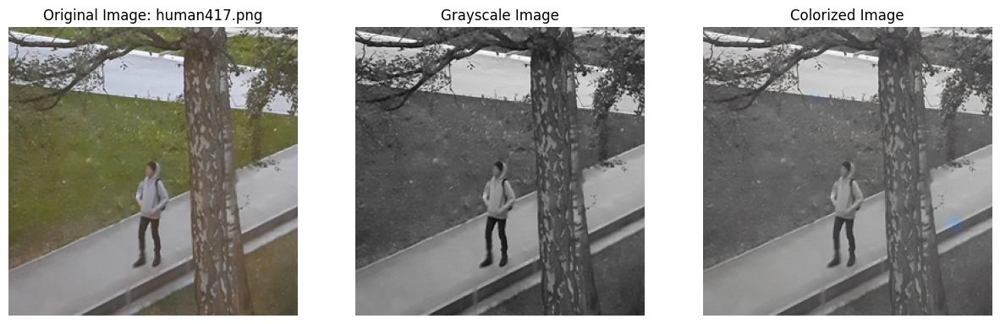

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


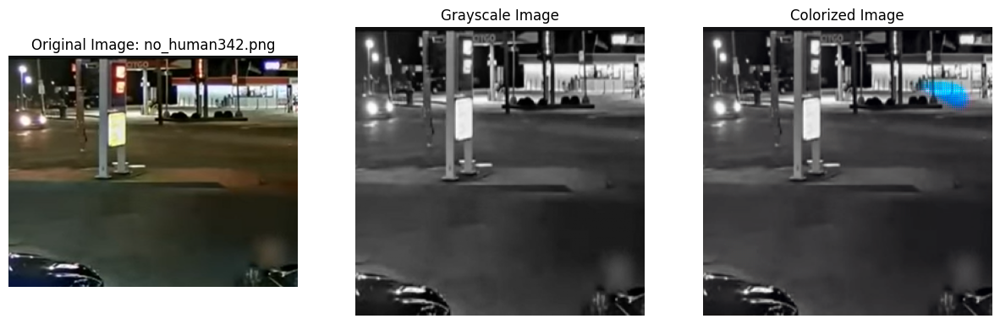

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


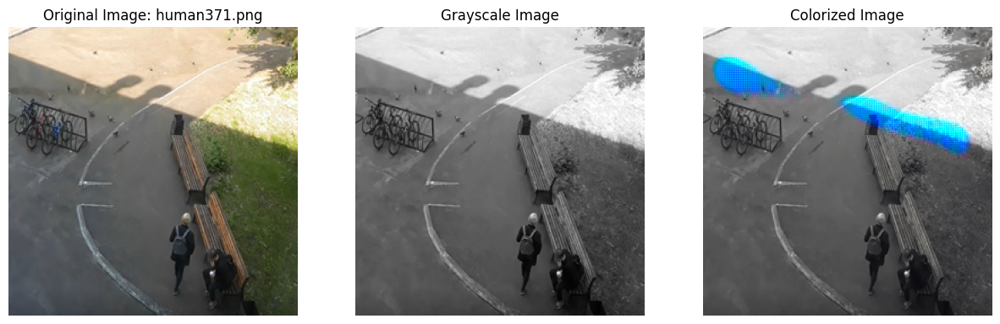

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


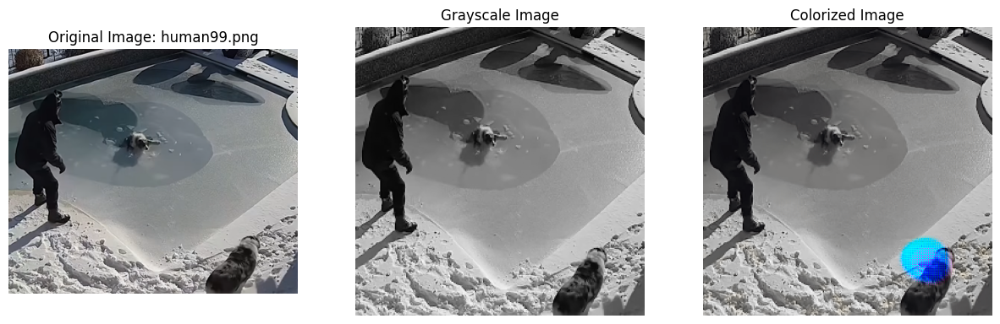

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


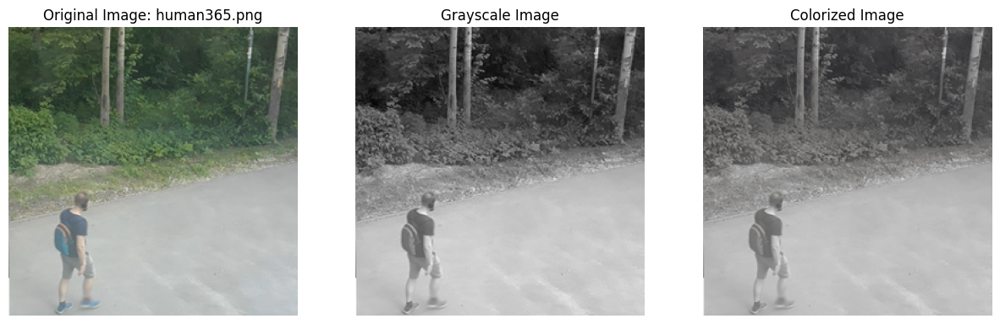

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


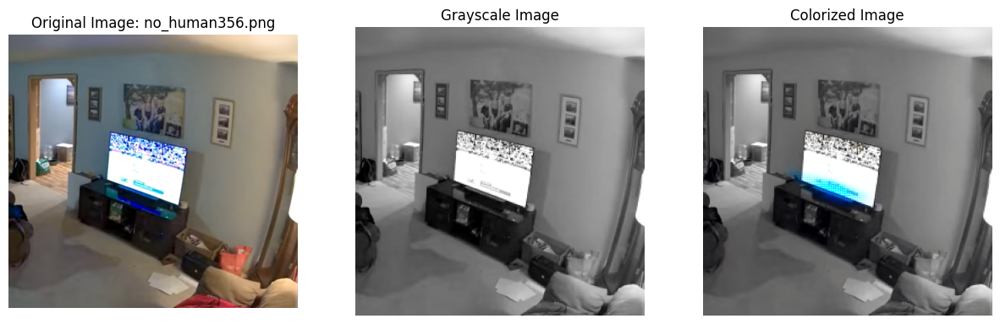

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


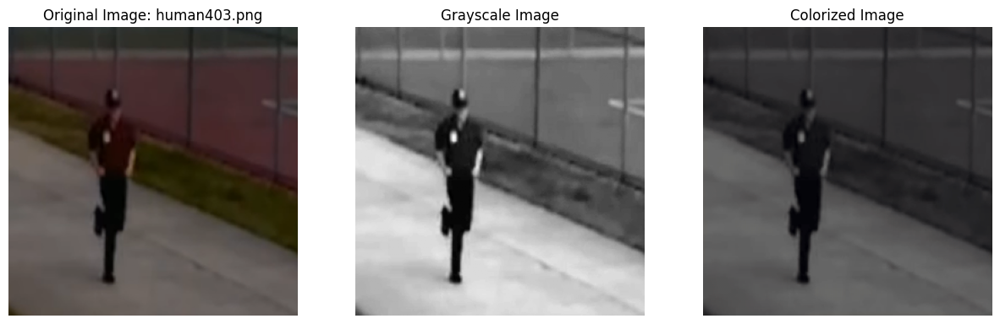

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


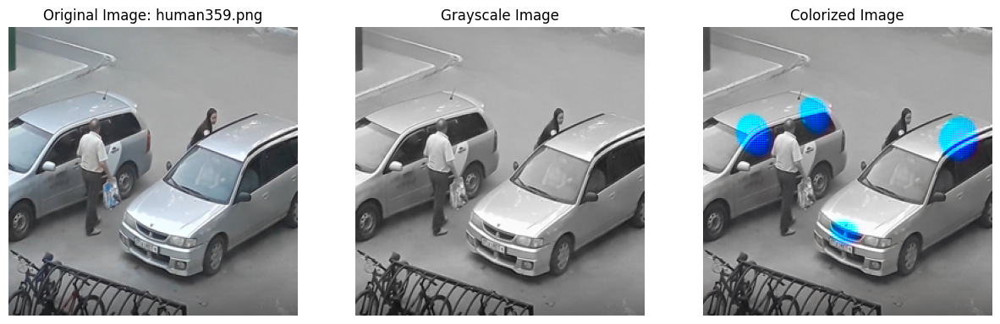

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


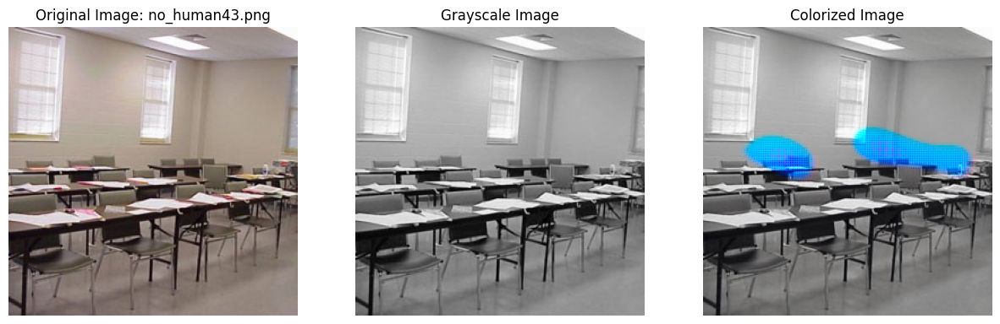

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


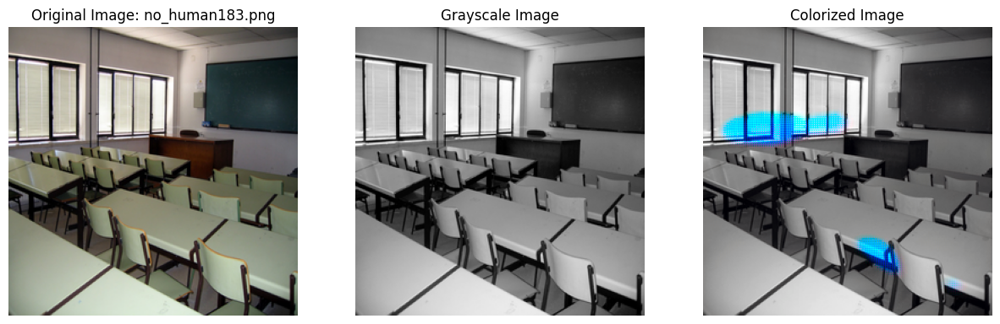

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


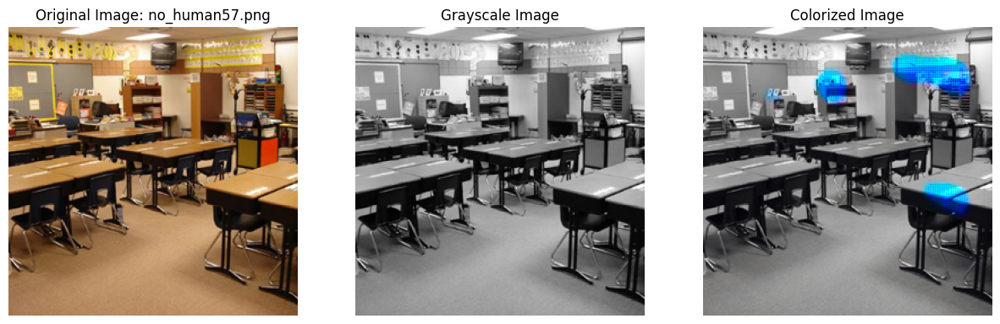

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


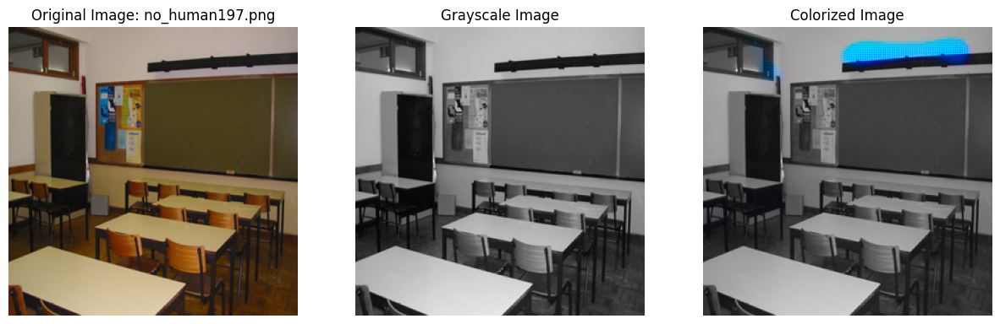

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


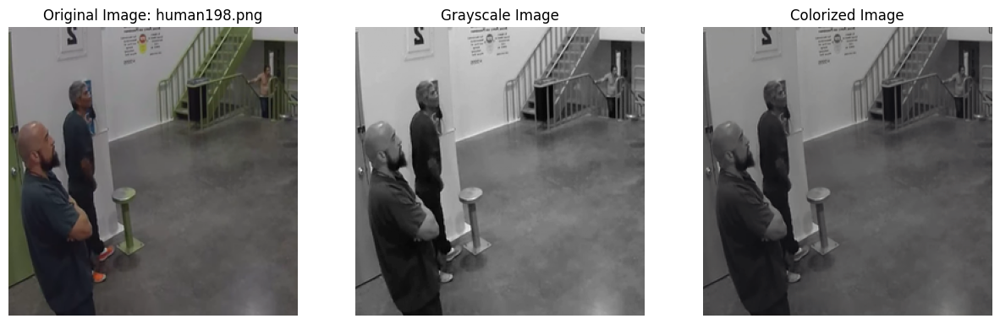

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


KeyboardInterrupt: 

In [3]:
import os

# Directory containing images
directory_path = "/Users/mehherghevandiani/Documents/personal/capstone/data/cctv_data"

# Iterate through all images in the directory
for filename in os.listdir(directory_path):
    if filename.endswith(".png") or filename.endswith(".jpg"):
        image_path = os.path.join(directory_path, filename)
        
        # Load and preprocess the image
        original_image = load_img(image_path)
        original_image = img_to_array(original_image) / 255.0  # Normalize the original image to [0, 1]
        l_channel, ab_channels = preprocess_image(image_path)
        
        # Predict the AB channels using the model
        l_channel_input = np.expand_dims(l_channel, axis=0)  # Add batch dimension
        predicted_ab_channels = model.predict(l_channel_input)[0]  # Remove batch dimension
        
        # Postprocess the predicted LAB image to RGB
        colorized_image = lab_to_rgb(l_channel, predicted_ab_channels)
        grayscale_image = l_channel[:, :, 0]  # Scale back to [0, 100] for visualization
        
        # Display the original, grayscale, and colorized images
        plt.figure(figsize=(15, 5))
        
        plt.subplot(1, 3, 1)
        plt.title(f"Original Image: {filename}")
        plt.imshow(original_image)
        plt.axis("off")
        
        plt.subplot(1, 3, 2)
        plt.title("Grayscale Image")
        plt.imshow(grayscale_image, cmap="gray")
        plt.axis("off")
        
        plt.subplot(1, 3, 3)
        plt.title("Colorized Image")
        plt.imshow(colorized_image)
        plt.axis("off")
        
        plt.show()